# Task - 1

In [2]:
!pip install -qU opencv-python


[notice] A new release of pip is available: 24.1.2 -> 24.2
[notice] To update, run: python3 -m pip install --upgrade pip



## Q1: Create a function to convert RGB to Grey scale image. Use numpy, pytorch, or tf but don't direct available functions.

Hint: Use the formula: Gray = 0.299*R + 0.587*G + 0.114*B for the conversion.

In [3]:
import numpy as np
from PIL import Image
rgb_image = np.array(Image.open("../Images/Business.png"))

In [4]:
np.shape(rgb_image)

(1080, 1920, 3)

In [5]:
import numpy as np
def rgb_to_grayscale(image_path):
    image = np.array(Image.open(image_path))
    """
    Convert an RGB image to grayscale.
    Parameters:
    image (numpy.ndarray): Input RGB image as a numpy array with shape (height, width, 3)
    
    Returns:
    numpy.ndarray: Grayscale image as a numpy array with shape (height, width)
    """
    # Check if the input image has 3 channels
    if image.shape[-1] != 3:
        raise ValueError("Input image must have 3 channels (RGB)")
    r, g, b = image[:,:,0], image[:,:,1], image[:,:,2]
    gray = 0.299 * r + 0.587 * g + 0.114 * b
    gray = np.clip(gray, 0, 255).astype(np.uint8)
    Image.fromarray(gray).show()
    return gray

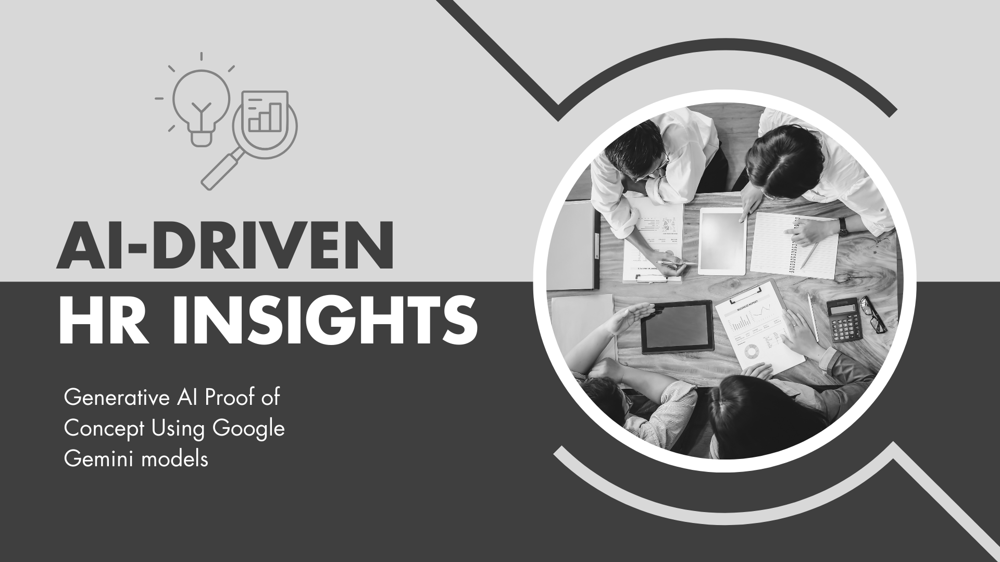

array([[216, 216, 216, ..., 216, 216, 216],
       [216, 216, 216, ..., 216, 216, 216],
       [216, 216, 216, ..., 216, 216, 216],
       ...,
       [ 63,  63,  63, ..., 216, 216, 216],
       [ 63,  63,  63, ..., 216, 216, 216],
       [ 63,  63,  63, ..., 216, 216, 216]], dtype=uint8)

In [6]:
rgb_to_grayscale("../Images/Business.png")

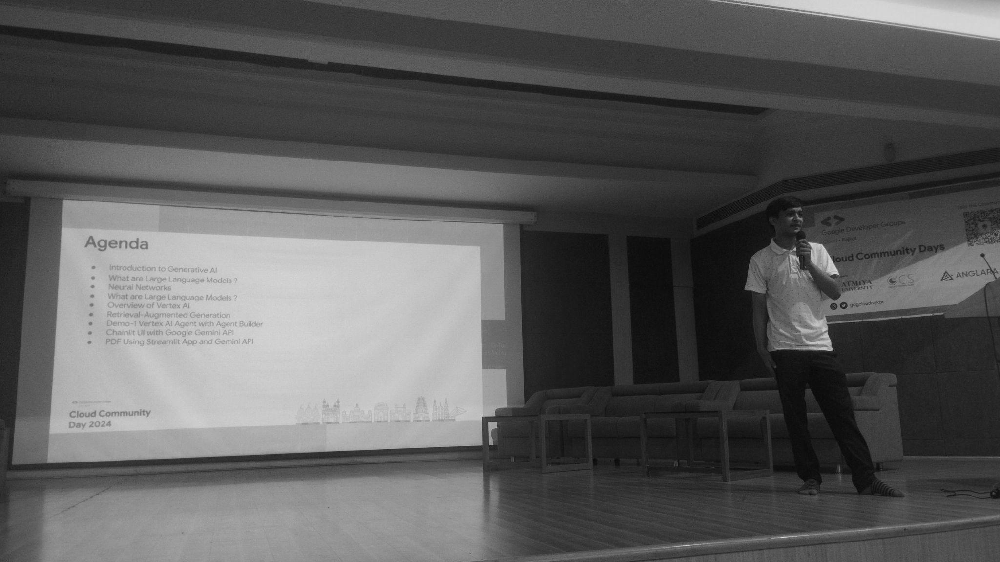

array([[ 53,  51,  49, ..., 156, 155, 155],
       [ 52,  49,  45, ..., 156, 156, 156],
       [ 53,  48,  45, ..., 157, 157, 157],
       ...,
       [ 66,  65,  66, ...,  75,  75,  73],
       [ 67,  66,  68, ...,  76,  77,  74],
       [ 63,  63,  65, ...,  77,  78,  75]], dtype=uint8)

In [7]:
rgb_to_grayscale("../Images/1722161153360.jpg")

## Q2 : Create a function to convolve_image taking image, kernel as input and returned convolved image.

Hint :  Easy Pesy - done in the class.  

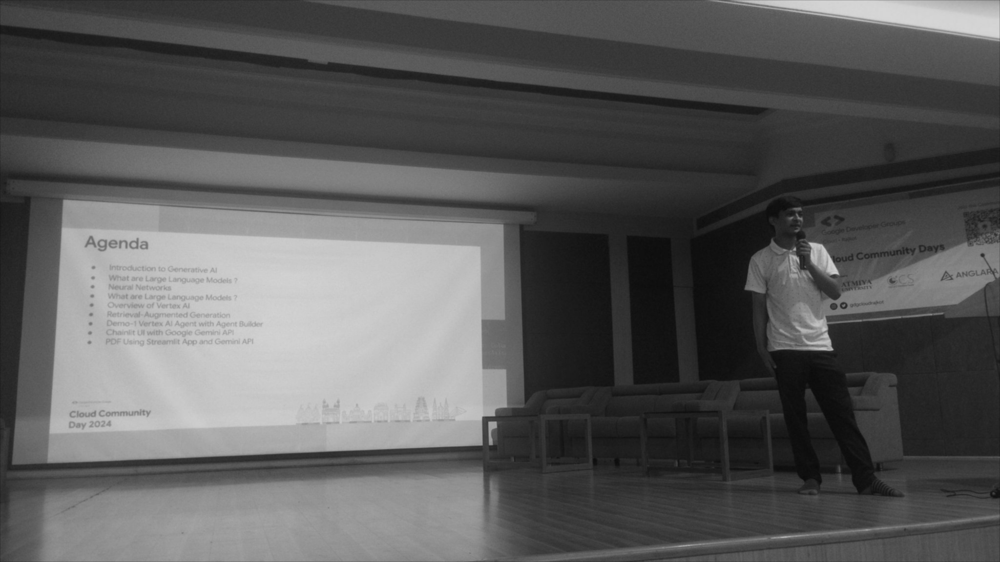

In [8]:
import numpy as np
from PIL import Image

import numpy as np

def convolve_image(image, kernel):
    """
    Convolve an image with a given kernel.
    
    Parameters:
    image (numpy.ndarray): Input image as a 2D numpy array
    kernel (numpy.ndarray): Convolution kernel as a 2D numpy array
    
    Returns:
    numpy.ndarray: Convolved image as a 2D numpy array
    """
    # Get image and kernel dimensions
    image_height, image_width = image.shape
    kernel_height, kernel_width = kernel.shape
    
    # Calculate padding
    pad_height = kernel_height // 2
    pad_width = kernel_width // 2
    
    # Pad the image
    padded_image = np.pad(image, ((pad_height, pad_height), (pad_width, pad_width)), mode='constant')
    
    # Initialize output image
    output = np.zeros_like(image)
    
    # Perform convolution
    for i in range(image_height):
        for j in range(image_width):
            output[i, j] = np.sum(padded_image[i:i+kernel_height, j:j+kernel_width] * kernel)
    
    return output

# Load an image (assuming it's grayscale)
image = np.array(Image.open("../Images/1722161153360.jpg").convert("L"))

# Define a kernel (e.g., a simple blur kernel)
kernel = np.array([[1, 2, 1],
                   [2, 4, 2],
                   [1, 2, 1]]) / 16  # Normalize the kernel

# Convolve the image
convolved_image = convolve_image(image, kernel)

# Display or save the result
Image.fromarray(convolved_image.astype(np.uint8)).show()


In [9]:
import numpy as np
from PIL import Image

# Function to apply kernel and display results
def apply_kernel(kernel, name):
    convolved = convolve_image(image, np.array(kernel))
    print(f"Effect of {name}:")
    print(f"Kernel:\n{np.array(kernel)}")
    print("Observation: [Effect description]")
    print()

    # In practice, you would display or save the image here
    Image.fromarray(convolved.astype(np.uint8)).show()


### 1. Identity Kernel

Effect of Identity Kernel:
Kernel:
[[0 0 0]
 [0 1 0]
 [0 0 0]]
Observation: [Effect description]



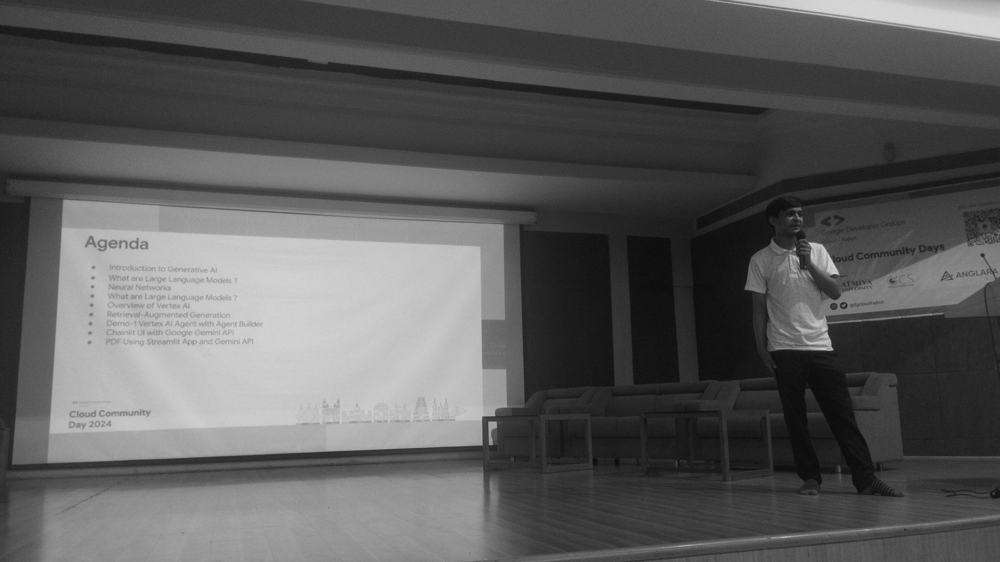

In [10]:
kernel1 = [[0, 0, 0],
           [0, 1, 0],
           [0, 0, 0]]
apply_kernel(kernel1, "Identity Kernel")


### 2. Edge Detection (Strong)


Effect of Strong Edge Detection:
Kernel:
[[-1 -1 -1]
 [-1  8 -1]
 [-1 -1 -1]]
Observation: [Effect description]



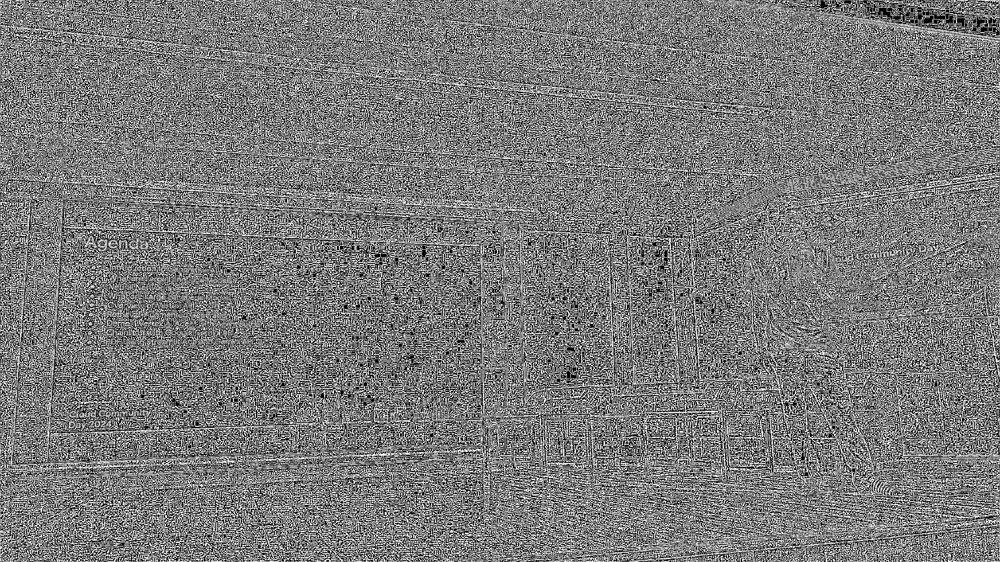

In [11]:
kernel2 = [[-1, -1, -1],
           [-1,  8, -1],
           [-1, -1, -1]]
apply_kernel(kernel2, "Strong Edge Detection")


### 3. Vertical Edge Detection (Sobel X)

Effect: This is the Sobel operator for detecting vertical edges. It will highlight vertical edges in the image, with the left side of edges becoming dark and the right side bright.

Effect of Vertical Edge Detection (Sobel X):
Kernel:
[[-1  0  1]
 [-2  0  2]
 [-1  0  1]]
Observation: [Effect description]



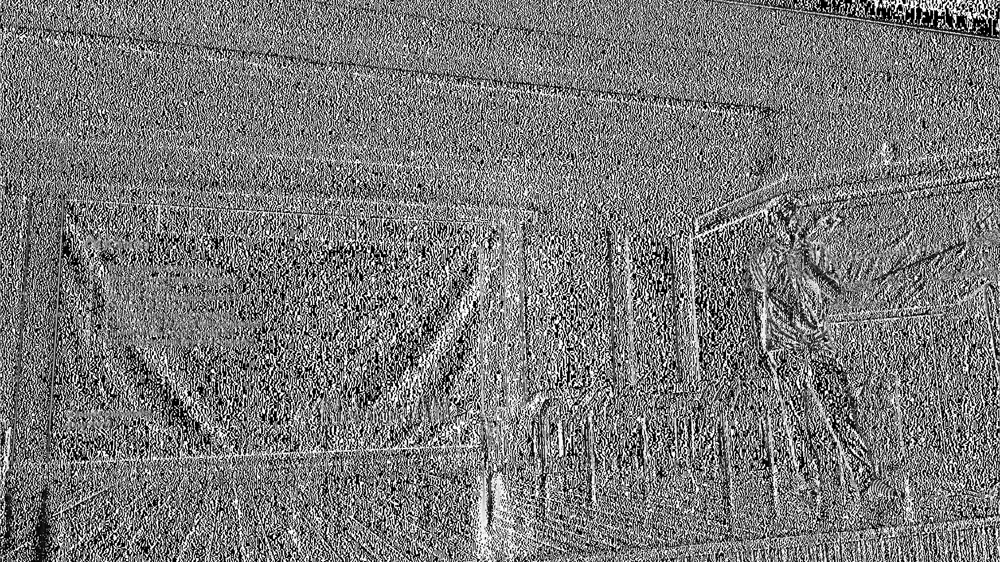

In [12]:
kernel3 = [[-1, 0, 1],
           [-2, 0, 2],
           [-1, 0, 1]]
apply_kernel(kernel3, "Vertical Edge Detection (Sobel X)")

### 4. Horizontal Edge Detection (Sobel Y)
Effect: This is the Sobel operator for detecting horizontal edges. It will highlight horizontal edges in the image, with the top side of edges becoming dark and the bottom side bright.

Effect of Horizontal Edge Detection (Sobel Y):
Kernel:
[[-1 -2 -1]
 [ 0  0  0]
 [ 1  2  1]]
Observation: [Effect description]



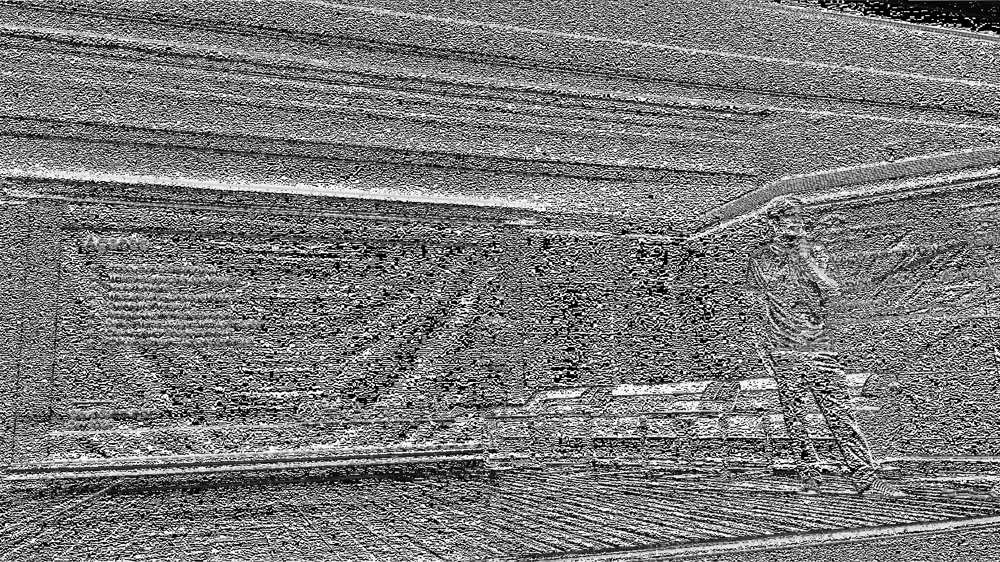

In [13]:
kernel4 = [[-1, -2, -1],
           [ 0,  0,  0],
           [ 1,  2,  1]]
apply_kernel(kernel4, "Horizontal Edge Detection (Sobel Y)")

### 5. Sharpening
Effect: This kernel sharpens the image by enhancing edges and fine details. It makes the image look crisper by increasing the contrast along edges.

Effect of Sharpening:
Kernel:
[[ 0 -1  0]
 [-1  5 -1]
 [ 0 -1  0]]
Observation: [Effect description]



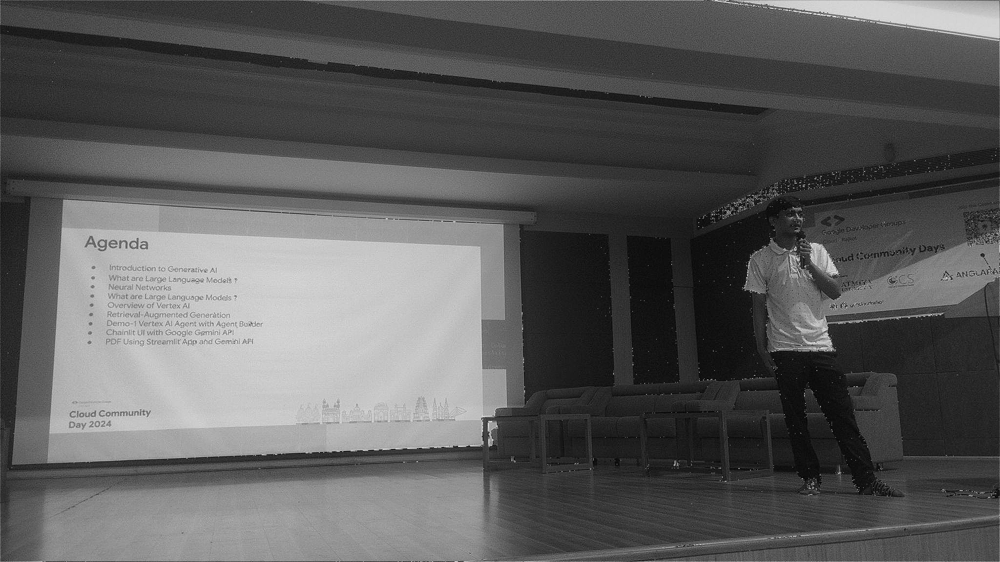

In [14]:
kernel5 = [[ 0, -1,  0],
           [-1,  5, -1],
           [ 0, -1,  0]]
apply_kernel(kernel5, "Sharpening")

### 6. Edge Detection (Laplacian)
Effect: This is the same as kernel 2. It performs edge detection using the Laplacian operator, highlighting all edges in the image

Effect of Edge Detection (Laplacian):
Kernel:
[[-1 -1 -1]
 [-1  8 -1]
 [-1 -1 -1]]
Observation: [Effect description]



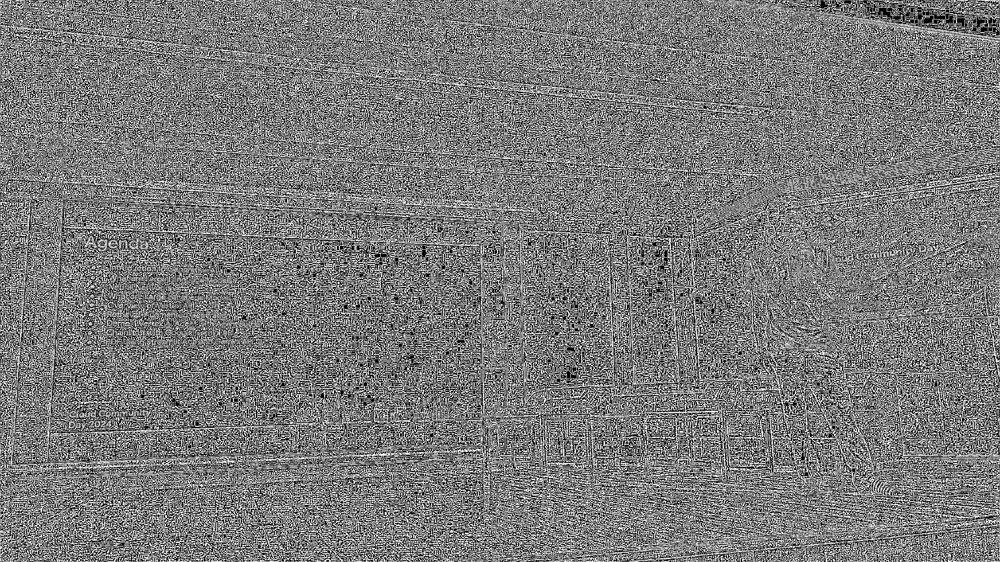

In [15]:
kernel6 = [[-1, -1, -1],
           [-1,  8, -1],
           [-1, -1, -1]]
apply_kernel(kernel6, "Edge Detection (Laplacian)")


### 7. Emboss
Effect: This kernel creates an embossed effect. It gives the image a 3D look by highlighting edges with a shadow-like effect, making it appear as if the image is raised.

Effect of Emboss:
Kernel:
[[-2 -1  0]
 [-1  1  1]
 [ 0  1  2]]
Observation: [Effect description]



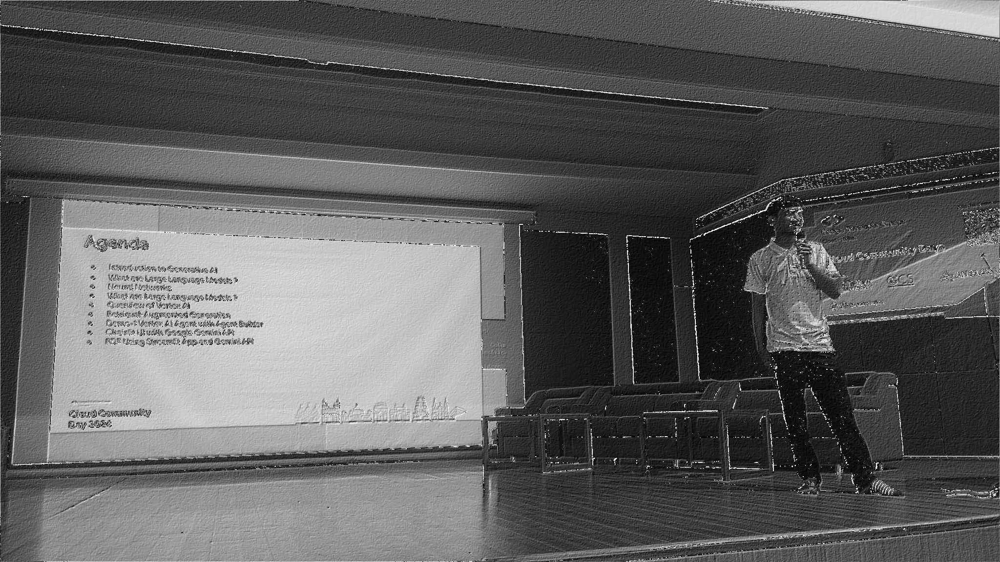

In [16]:
kernel7 = [[-2, -1,  0],
           [-1,  1,  1],
           [ 0,  1,  2]]
apply_kernel(kernel7, "Emboss")

### 8. Box Blur
Effect: This is a simple blur kernel. It averages each pixel with its neighbors, resulting in a blurred image. The effect is a uniform softening of the image.

Effect of Box Blur:
Kernel:
[[0.111 0.111 0.111]
 [0.111 0.111 0.111]
 [0.111 0.111 0.111]]
Observation: [Effect description]



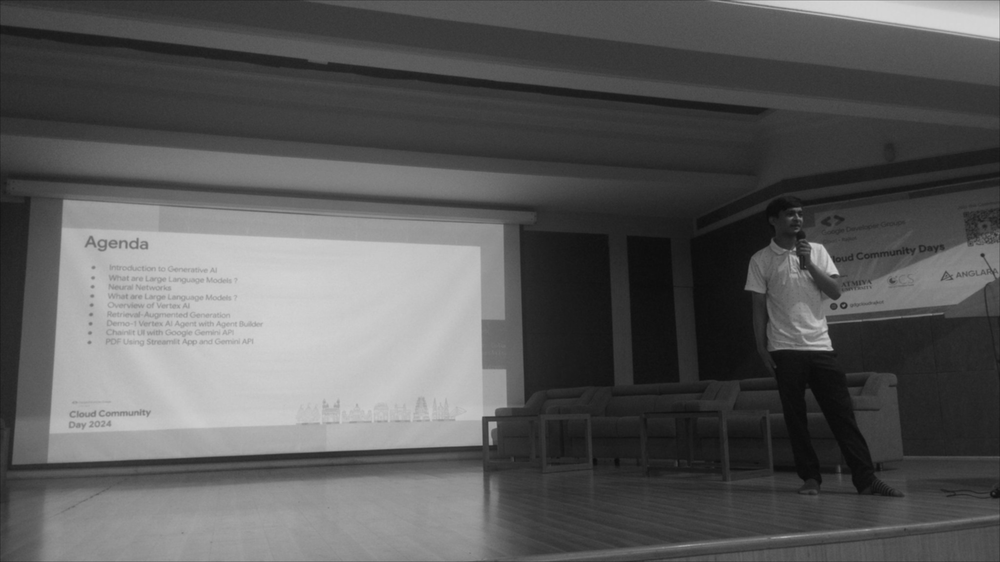

In [17]:
kernel8 = [[0.111, 0.111, 0.111],
           [0.111, 0.111, 0.111],
           [0.111, 0.111, 0.111]]
apply_kernel(kernel8, "Box Blur")



When applying these kernels to an actual image, you would see these effects visually. The edge detection kernels (2, 3, 4, 6) would highlight edges in white against a dark background. The sharpening kernel (5) would make the image look more crisp. The emboss kernel (7) would give a 3D effect, and the blur kernel (8) would soften the image.

Remember that the intensity of these effects can vary depending on the image content and might need to be adjusted by scaling the kernel values or applying the convolution multiple times for stronger effects.

Effect of Identity:
Kernel:
[[0 0 0]
 [0 1 0]
 [0 0 0]]
Observation: The identity filter has been applied to the image.

Effect of Strong Edge Detection:
Kernel:
[[-1 -1 -1]
 [-1  8 -1]
 [-1 -1 -1]]
Observation: The strong edge detection filter has been applied to the image.

Effect of Vertical Edge Detection (Sobel X):
Kernel:
[[-1  0  1]
 [-2  0  2]
 [-1  0  1]]
Observation: The vertical edge detection (sobel x) filter has been applied to the image.

Effect of Horizontal Edge Detection (Sobel Y):
Kernel:
[[-1 -2 -1]
 [ 0  0  0]
 [ 1  2  1]]
Observation: The horizontal edge detection (sobel y) filter has been applied to the image.

Effect of Sharpening:
Kernel:
[[ 0 -1  0]
 [-1  5 -1]
 [ 0 -1  0]]
Observation: The sharpening filter has been applied to the image.

Effect of Edge Detection (Laplacian):
Kernel:
[[-1 -1 -1]
 [-1  8 -1]
 [-1 -1 -1]]
Observation: The edge detection (laplacian) filter has been applied to the image.

Effect of Emboss:
Kernel:
[[-2 -1  0]
 [-1  1  1]
 [ 0  1  

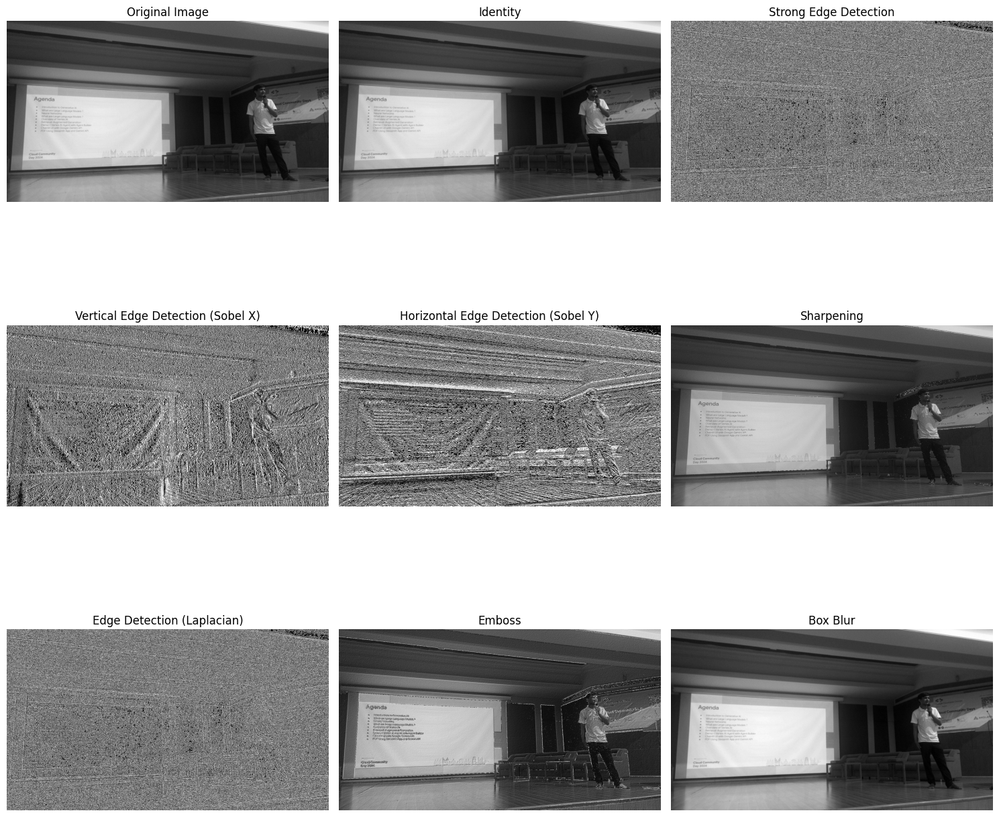

In [21]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

class ImageProcessor:
    def __init__(self, image_path):
        self.image = np.array(Image.open(image_path).convert("L"))
        self.kernels = {
            "Identity": [[0, 0, 0], [0, 1, 0], [0, 0, 0]],
            "Strong Edge Detection": [[-1, -1, -1], [-1, 8, -1], [-1, -1, -1]],
            "Vertical Edge Detection (Sobel X)": [[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]],
            "Horizontal Edge Detection (Sobel Y)": [[-1, -2, -1], [0, 0, 0], [1, 2, 1]],
            "Sharpening": [[0, -1, 0], [-1, 5, -1], [0, -1, 0]],
            "Edge Detection (Laplacian)": [[-1, -1, -1], [-1, 8, -1], [-1, -1, -1]],
            "Emboss": [[-2, -1, 0], [-1, 1, 1], [0, 1, 2]],
            "Box Blur": [[0.111, 0.111, 0.111], [0.111, 0.111, 0.111], [0.111, 0.111, 0.111]]
        }

    def convolve_image(self, image, kernel):
        # Get image dimensions
        image_height, image_width = image.shape
        
        # Get kernel dimensions
        kernel_height, kernel_width = kernel.shape
        
        # Calculate padding
        pad_height = kernel_height // 2
        pad_width = kernel_width // 2
        
        # Create padded image
        padded_image = np.pad(image, ((pad_height, pad_height), (pad_width, pad_width)), mode='edge')
        
        # Create output image
        output = np.zeros_like(image)
        
        # Perform convolution
        for y in range(image_height):
            for x in range(image_width):
                output[y, x] = np.sum(kernel * padded_image[y:y+kernel_height, x:x+kernel_width])
        
        # Normalize the output
        output = (output - output.min()) / (output.max() - output.min()) * 255
        
        return output.astype(np.uint8)

    def apply_kernels(self):
        fig, axs = plt.subplots(3, 3, figsize=(15, 15))
        axs = axs.ravel()

        axs[0].imshow(self.image, cmap='gray')
        axs[0].set_title("Original Image")
        axs[0].axis('off')

        for i, (name, kernel) in enumerate(self.kernels.items(), 1):
            convolved = self.convolve_image(self.image, np.array(kernel))
            axs[i].imshow(convolved, cmap='gray')
            axs[i].set_title(name)
            axs[i].axis('off')

            print(f"Effect of {name}:")
            print(f"Kernel:\n{np.array(kernel)}")
            print(f"Observation: The {name.lower()} filter has been applied to the image.")
            print()

        plt.tight_layout()
        plt.show()

# Usage

image_path = "../Images/1722161153360.jpg"
processor = ImageProcessor(image_path)
processor.apply_kernels()


Effect of Identity:
Kernel:
[[0 0 0]
 [0 1 0]
 [0 0 0]]
Observation: The identity filter has been applied to the image.

Effect of Strong Edge Detection:
Kernel:
[[-1 -1 -1]
 [-1  8 -1]
 [-1 -1 -1]]
Observation: The strong edge detection filter has been applied to the image.

Effect of Vertical Edge Detection (Sobel X):
Kernel:
[[-1  0  1]
 [-2  0  2]
 [-1  0  1]]
Observation: The vertical edge detection (sobel x) filter has been applied to the image.

Effect of Horizontal Edge Detection (Sobel Y):
Kernel:
[[-1 -2 -1]
 [ 0  0  0]
 [ 1  2  1]]
Observation: The horizontal edge detection (sobel y) filter has been applied to the image.

Effect of Sharpening:
Kernel:
[[ 0 -1  0]
 [-1  5 -1]
 [ 0 -1  0]]
Observation: The sharpening filter has been applied to the image.

Effect of Edge Detection (Laplacian):
Kernel:
[[-1 -1 -1]
 [-1  8 -1]
 [-1 -1 -1]]
Observation: The edge detection (laplacian) filter has been applied to the image.

Effect of Emboss:
Kernel:
[[-2 -1  0]
 [-1  1  1]
 [ 0  1  

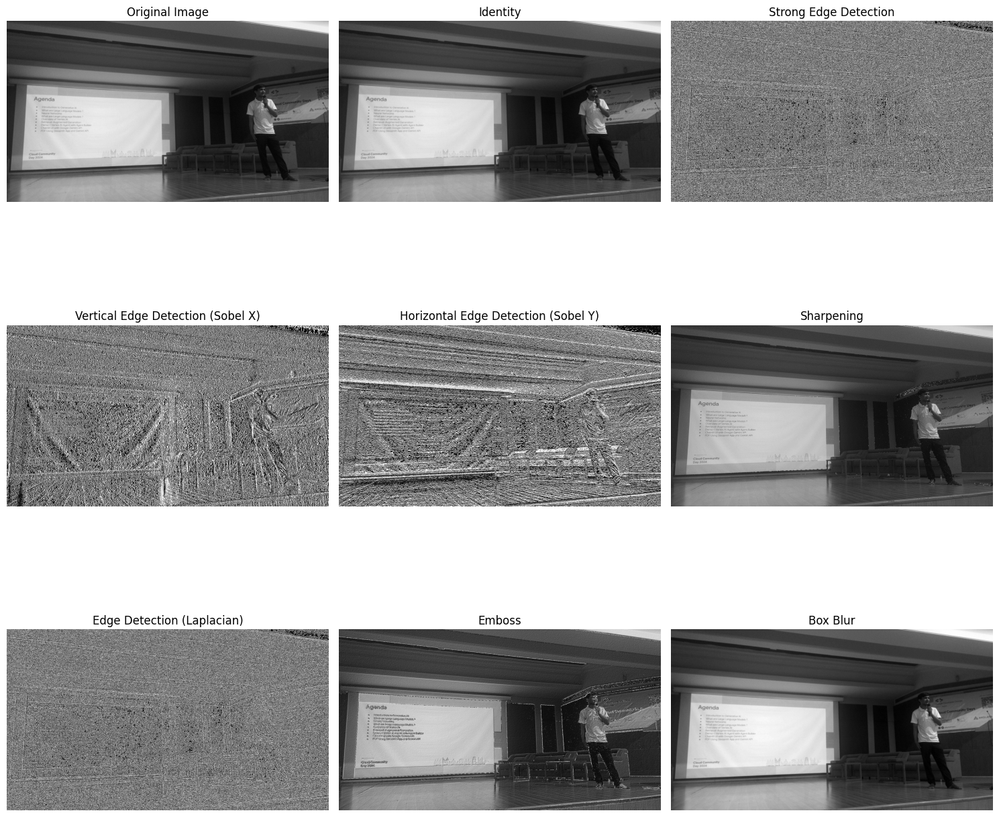

In [22]:
image_path = "../Images/1722161153360.jpg"
processor = ImageProcessor(image_path)
processor.apply_kernels()

In [25]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def filter_and_transform(image_path, blur_kernel_size=5, rotation_angle=45):
    """
    Apply Gaussian blur and rotation to an image.
    
    Args:
    image_path (str): Path to the input image.
    blur_kernel_size (int): Size of the Gaussian kernel. Must be odd and positive.
    rotation_angle (float): Angle of rotation in degrees.
    
    Returns:
    tuple: Original image, blurred image, and rotated image.
    """
    # Read the image
    img = cv2.imread(image_path)
    
    # Convert BGR to RGB (OpenCV uses BGR by default)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    # Apply Gaussian blur
    blurred = cv2.GaussianBlur(img_rgb, (blur_kernel_size, blur_kernel_size), 0)
    
    # Get the image dimensions
    height, width = img_rgb.shape[:2]
    
    # Calculate the rotation matrix
    rotation_matrix = cv2.getRotationMatrix2D((width/2, height/2), rotation_angle, 1)
    
    # Perform the rotation
    rotated = cv2.warpAffine(blurred, rotation_matrix, (width, height))
    
    return img_rgb, blurred, rotated

def display_images(original, blurred, rotated):
    """
    Display the original, blurred, and rotated images side by side.
    """
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5))
    
    ax1.imshow(original)
    ax1.set_title('Original')
    ax1.axis('off')
    
    ax2.imshow(blurred)
    ax2.set_title('Gaussian Blur')
    ax2.axis('off')
    
    ax3.imshow(rotated)
    ax3.set_title('Rotated')
    ax3.axis('off')
    
    plt.tight_layout()
    plt.show()

# Usage
image_path = '../Images/1722161153360.jpg'
original, blurred, rotated = filter_and_transform(image_path, blur_kernel_size=5, rotation_angle=45)
display_images(original, blurred, rotated)

ImportError: libGL.so.1: cannot open shared object file: No such file or directory